In [18]:
%load_ext autoreload
%autoreload 2
import tqdm, tqdm.notebook
tqdm.tqdm = tqdm.notebook.tqdm  # notebook-friendly progress bars
from pathlib import Path
import numpy as np

from hloc import extract_features, match_features, reconstruction, visualization, pairs_from_exhaustive, pairs_from_minseong, pairs_from_retrieval
from hloc.visualization import plot_images, read_image
from hloc.utils import viz_3d

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# Pipeline for indoor localization

In [71]:
images = Path('datasets/inloc/database/cutouts/DUC1/')
outputs = Path('outputs/inloc/DUC1')  # where everything will be saved
pairs = Path('pairs/inloc/')
sfm_dir = outputs / 'sfm'
sfm_pairs_re = outputs / 'pairs-sfm-retrieval.txt'
loc_pairs = pairs / 'pairs-loc.txt'
local_features = outputs / 'local_features.h5'
query_local_features = outputs / 'query_local_features.h5'
global_features = outputs / 'global_features.h5'
matches = outputs / 'matches.h5'
loc_matches = outputs / 'loc_matches.h5'
results = outputs / 'InLoc_hloc_disk+lightglue_cosplace.txt'  # the result file

In [30]:
# !rm -rf $outputs

In [44]:
# references = [p.relative_to(images).as_posix() for p in (images).iterdir()]
for p in (images).iterdir():
    for t in p.iterdir():
        references.append(t.relative_to(images).as_posix())
print(len(references), "mapping images")

1800 mapping images


In [46]:
feature_conf = extract_features.confs['disk']
g_feature_conf = extract_features.confs['cosplace']
matcher_conf = match_features.confs['disk+lightglue']

In [47]:
extract_features.main(feature_conf, images, image_list=references, feature_path=local_features)
extract_features.main(image_dir=images, conf=g_feature_conf, image_list=references, feature_path=global_features)

[2023/08/28 16:02:54 hloc INFO] Extracting local features with configuration:
{'model': {'max_keypoints': 5000, 'name': 'disk'},
 'output': 'feats-disk',
 'preprocessing': {'grayscale': False, 'resize_max': 1600}}
100%|███████████████████████████████████████| 1800/1800 [03:52<00:00,  7.76it/s]
[2023/08/28 16:06:46 hloc INFO] Finished exporting features.
[2023/08/28 16:06:46 hloc INFO] Extracting local features with configuration:
{'model': {'name': 'cosplace'},
 'output': 'global-feats-cosplace',
 'preprocessing': {'resize_max': 1024}}
Using cache found in /home/minseong/.cache/torch/hub/gmberton_CosPlace_main


Returning CosPlace model with backbone: ResNet50 with features dimension 2048


100%|███████████████████████████████████████| 1800/1800 [02:51<00:00, 10.50it/s]
[2023/08/28 16:09:39 hloc INFO] Finished exporting features.


PosixPath('outputs/inloc/DUC1/global_features.h5')

In [50]:
pairs_from_retrieval.main(descriptors=global_features, output=sfm_pairs_re, num_matched=20)

[2023/08/28 16:11:35 hloc INFO] Extracting image pairs from a retrieval database.


1
2
3
4
5
7


[2023/08/28 16:11:38 hloc INFO] Found 36000 pairs.


In [55]:
match_features.main(matcher_conf, sfm_pairs_re, features=local_features, matches=matches);

[2023/08/28 16:13:33 hloc INFO] Matching local features with configuration:
{'model': {'features': 'disk', 'name': 'lightglue'},
 'output': 'matches-disk-lightglue'}
100%|█████████████████████████████████████| 25093/25093 [17:09<00:00, 24.38it/s]
[2023/08/28 16:30:42 hloc INFO] Finished exporting matches.


[2023/08/28 16:30:42 hloc INFO] Creating an empty database...
[2023/08/28 16:30:43 hloc INFO] Importing images into the database...
[2023/08/28 16:31:42 hloc INFO] Importing features into the database...


  0%|          | 0/1800 [00:00<?, ?it/s]

[2023/08/28 16:31:45 hloc INFO] Importing matches into the database...


  0%|          | 0/36000 [00:00<?, ?it/s]

[2023/08/28 16:32:09 hloc INFO] Performing geometric verification of the matches...
[2023/08/28 16:32:53 hloc INFO] Running 3D reconstruction...
W0828 16:33:23.476068 2039636 levenberg_marquardt_strategy.cc:123] Linear solver failure. Failed to compute a step: Eigen failure. Unable to perform dense Cholesky factorization.
W0828 16:33:23.483098 2039636 levenberg_marquardt_strategy.cc:123] Linear solver failure. Failed to compute a step: Eigen failure. Unable to perform dense Cholesky factorization.
W0828 16:33:23.558461 2039636 levenberg_marquardt_strategy.cc:123] Linear solver failure. Failed to compute a step: Eigen failure. Unable to perform dense Cholesky factorization.
W0828 16:33:23.565321 2039636 levenberg_marquardt_strategy.cc:123] Linear solver failure. Failed to compute a step: Eigen failure. Unable to perform dense Cholesky factorization.
W0828 16:33:23.572257 2039636 levenberg_marquardt_strategy.cc:123] Linear solver failure. Failed to compute a step: Eigen failure. Unable t

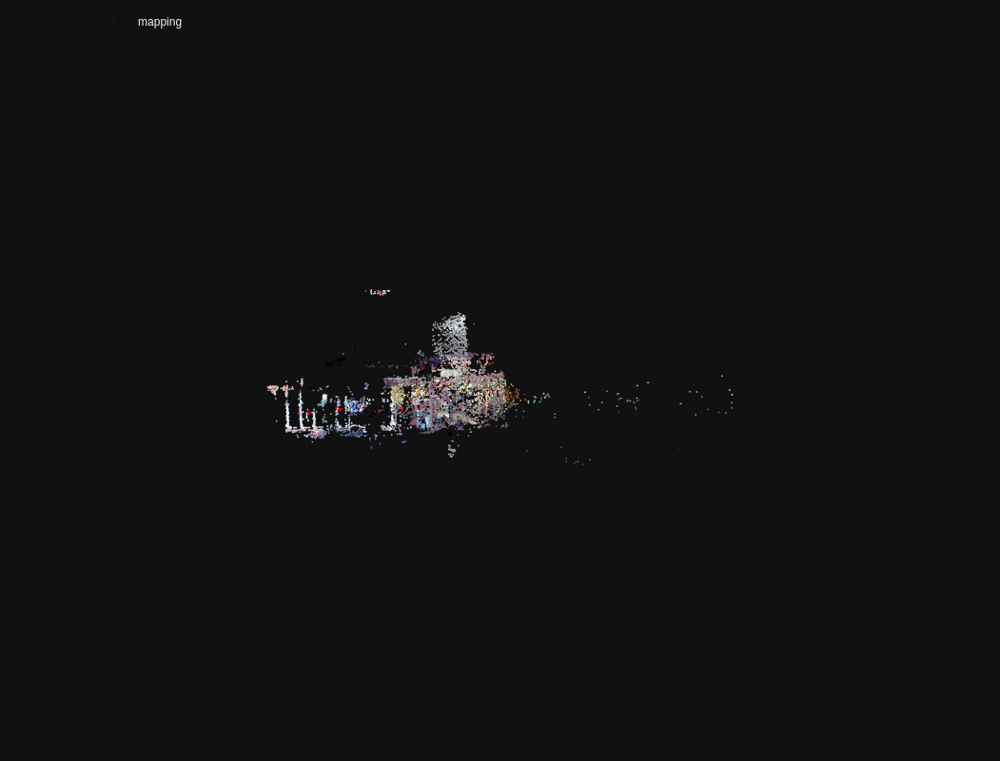

In [56]:
model = reconstruction.main(sfm_dir, images, sfm_pairs_re, local_features, matches, image_list=references)
fig = viz_3d.init_figure()
viz_3d.plot_reconstruction(fig, model, color='rgba(255,0,0,0.5)', name="mapping", points_rgb=True)
fig.show()

In [76]:
import pycolmap
from hloc.localize_sfm import QueryLocalizer, pose_from_cluster

In [77]:
query = Path('datasets/inloc/query/iphone7/')

In [78]:
query_ref = [p.relative_to(query).as_posix() for p in (query).iterdir()]

In [79]:
len(query_ref)

356

In [80]:
for reference in references:
    if model.find_image_with_name(reference) == None:
        continue
    else:
        ref_ids.append(model.find_image_with_name(reference).image_id)

In [92]:
len(references)

1800

In [81]:
conf = {
    'estimation': {'ransac': {'max_error': 12}},
    'refinement': {'refine_focal_length': True, 'refine_extra_params': True},
}

In [97]:
for q in query_ref:
    cur_query = q
    extract_features.main(feature_conf, query, image_list=[cur_query], feature_path=local_features, overwrite=True)
    pairs_from_exhaustive.main(loc_pairs, image_list=[cur_query], ref_list=references)
    match_features.main(matcher_conf, loc_pairs, features=local_features, matches=matches, overwrite=True)

    camera = pycolmap.infer_camera_from_image(query / q)
    localizer = QueryLocalizer(model, conf)
    ret, log = pose_from_cluster(localizer, str(query / q), camera, ref_ids, local_features, matches)
    print('tvec: '+ret['tvec'], ' qvec: '+ret['qvec'])

[2023/08/29 10:19:29 hloc INFO] Extracting local features with configuration:
{'model': {'max_keypoints': 5000, 'name': 'disk'},
 'output': 'feats-disk',
 'preprocessing': {'grayscale': False, 'resize_max': 1600}}
100%|█████████████████████████████████████████████| 1/1 [00:00<00:00,  1.10it/s]
[2023/08/29 10:19:30 hloc INFO] Finished exporting features.
[2023/08/29 10:19:30 hloc INFO] Found 1800 pairs.
[2023/08/29 10:19:30 hloc INFO] Matching local features with configuration:
{'model': {'features': 'disk', 'name': 'lightglue'},
 'output': 'matches-disk-lightglue'}
100%|███████████████████████████████████████| 1800/1800 [01:13<00:00, 24.40it/s]
[2023/08/29 10:20:44 hloc INFO] Finished exporting matches.


KeyError: 'Unable to open object (component not found)'

In [95]:
query / q

PosixPath('datasets/inloc/query/iphone7/IMG_0846.JPG')

In [98]:
local_features

PosixPath('outputs/inloc/DUC1/local_features.h5')

In [96]:
str(query / q)

'datasets/inloc/query/iphone7/IMG_0846.JPG'

In [72]:
extract_features.main(feature_conf, query, image_list=query_ref, feature_path=query_local_features)

[2023/08/29 09:51:23 hloc INFO] Extracting local features with configuration:
{'model': {'max_keypoints': 5000, 'name': 'disk'},
 'output': 'feats-disk',
 'preprocessing': {'grayscale': False, 'resize_max': 1600}}
100%|█████████████████████████████████████████| 356/356 [03:25<00:00,  1.73it/s]
[2023/08/29 09:54:48 hloc INFO] Finished exporting features.


PosixPath('outputs/inloc/DUC1/query_local_features.h5')

In [ ]:
extract_features.main(feature_conf, images, image_list=[query], feature_path=local_features, overwrite=True)
match_features.main(matcher_conf, loc_pairs, features=local_features, matches=matches, overwrite=True);

In [ ]:
import pycolmap
from hloc.localize_sfm import QueryLocalizer, pose_from_cluster

In [74]:
camera = pycolmap.infer_camera_from_image(images / query)
# ref_ids = [model.find_image_with_name(r).image_id for r in references]
ref_ids = []
for reference in references:
    # print(model.find_image_with_name(reference).image_id)
    # print(reference)
    # print(model.find_image_with_name(reference))
    if model.find_image_with_name(reference) == None:
        continue
    else:
        ref_ids.append(model.find_image_with_name(reference).image_id)

conf = {
    'estimation': {'ransac': {'max_error': 12}},
    'refinement': {'refine_focal_length': True, 'refine_extra_params': True},
}
localizer = QueryLocalizer(model, conf)
ret, log = pose_from_cluster(localizer, query, camera, ref_ids, local_features, matches)

TypeError: Accessing a group is done with bytes or str, not <class 'list'>

In [ ]:
pairs_from_exhaustive.main(loc_pairs, image_list=query_ref, ref_list=references)

In [63]:
match_features.main(matcher_conf, loc_pairs, features=local_features, matches=matches, overwrite=True)

[2023/08/29 09:44:01 hloc INFO] Extracting local features with configuration:
{'model': {'max_keypoints': 5000, 'name': 'disk'},
 'output': 'feats-disk',
 'preprocessing': {'grayscale': False, 'resize_max': 1600}}


ValueError: Image IMG_0846.JPG does not exists in root: datasets/inloc/database/cutouts/DUC1.